17. What is the average number of breaks of serve per match?

Loading Data:

In [1]:
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns


folder_path = Path('../data/input/raw_match_parquet')
folder_path1 = Path('../data/input/raw_tennis_power_parquet')

# Power Data
power_dfs = []

for parquet_file in folder_path1.glob('power_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=['match_id','break_occurred'])
        power_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if power_dfs:
    power_data = pd.concat(power_dfs, ignore_index=True)
    print("\n--- Combined Event DataFrame Info ---")
    print(power_data.shape)
    print(power_data.head())
    print(f"Successfully combined {len(power_dfs)} event parquet files.")
else:
    print(f"No 'event_*.parquet' files found in {folder_path} or no files could be read.")



# Away Team Data
all_away_team_dfs = []

for parquet_file in folder_path.glob('away_team_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=['match_id', 'gender'])
        all_away_team_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if all_away_team_dfs:
    away_team_data = pd.concat(all_away_team_dfs, ignore_index=True)
    print("\n--- Combined Away Team DataFrame Info ---")
    print(away_team_data.shape)
    print(away_team_data.head())
    print(f"Successfully combined {len(all_away_team_dfs)} away team parquet files.")
else:
    print(f"No 'away_team_*.parquet' files found in {folder_path} or no files could be read.")

# Home Team Data
all_home_team_dfs = []

for parquet_file in folder_path.glob('home_team_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=['match_id', 'gender'])
        all_home_team_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if all_home_team_dfs:
    home_team_data = pd.concat(all_home_team_dfs, ignore_index=True)
    print("\n--- Combined Home Team DataFrame Info ---")
    print(home_team_data.shape)
    print(home_team_data.head())
    print(f"Successfully combined {len(all_home_team_dfs)} home team parquet files.")
else:
    print(f"No 'home_team_*.parquet' files found in {folder_path} or no files could be read.")

Successfully read power_11998445.parquet
Successfully read power_11998446.parquet
Successfully read power_11998447.parquet
Successfully read power_11998448.parquet
Successfully read power_11998449.parquet
Successfully read power_11998450.parquet
Successfully read power_11998451.parquet
Successfully read power_11998452.parquet
Successfully read power_11998453.parquet
Successfully read power_11998454.parquet
Successfully read power_11998455.parquet
Successfully read power_11998456.parquet
Successfully read power_11998457.parquet
Successfully read power_11998458.parquet
Successfully read power_11998459.parquet
Successfully read power_11998663.parquet
Successfully read power_11998664.parquet
Successfully read power_11998666.parquet
Successfully read power_11998667.parquet
Successfully read power_11998670.parquet
Successfully read power_11998671.parquet
Successfully read power_11998672.parquet
Successfully read power_11998673.parquet
Successfully read power_11998674.parquet
Successfully rea

Distribution of Breaks of Serve per Match


🎾 Average Number of Breaks per Match: 6.93


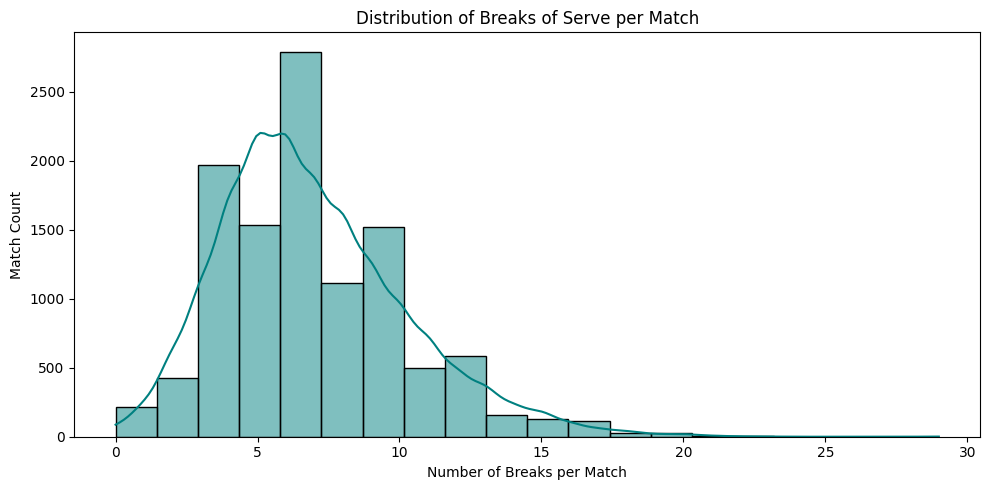

In [3]:
power_data['break_occurred'] = power_data['break_occurred'].astype(bool)

breaks_per_match = power_data.groupby('match_id')['break_occurred'].sum().reset_index(name='num_breaks')

average_breaks = breaks_per_match['num_breaks'].mean()
print(f"\n🎾 Average Number of Breaks per Match: {average_breaks:.2f}")


plt.figure(figsize=(10, 5))
sns.histplot(breaks_per_match['num_breaks'], bins=20, kde=True, color='teal')
plt.title('Distribution of Breaks of Serve per Match')
plt.xlabel('Number of Breaks per Match')
plt.ylabel('Match Count')
plt.tight_layout()
# Saving the output as png.
output_directory = Path('../data/output')
file_name = "Distribution of Breaks of Serve per Match.png" 
full_path = output_directory / file_name
plt.savefig(full_path, dpi=300)
plt.show()

Average Breaks of Serve per Match by Gender

Average Number of Breaks per Match by Gender:
  gender  num_breaks
0      F    8.083681
1      M    6.033898


C:\Users\Parsan Afzar\AppData\Local\Temp\ipykernel_14688\2560163434.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=avg_breaks_by_gender, x='gender', y='num_breaks', palette='pastel')


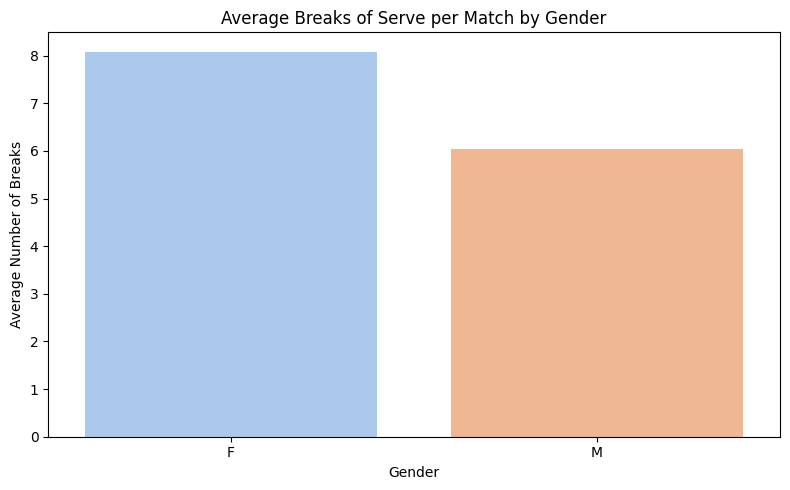

In [4]:
power_data['break_occurred'] = power_data['break_occurred'].astype(bool)

breaks_per_match = power_data.groupby('match_id')['break_occurred'].sum().reset_index(name='num_breaks')

match_gender = home_team_data[['match_id', 'gender']].drop_duplicates()

breaks_with_gender = breaks_per_match.merge(match_gender, on='match_id', how='left')
breaks_with_gender = breaks_with_gender.dropna(subset=['gender'])

avg_breaks_by_gender = breaks_with_gender.groupby('gender')['num_breaks'].mean().reset_index()
print("Average Number of Breaks per Match by Gender:")
print(avg_breaks_by_gender)

plt.figure(figsize=(8, 5))
sns.barplot(data=avg_breaks_by_gender, x='gender', y='num_breaks', palette='pastel')
plt.title('Average Breaks of Serve per Match by Gender')
plt.xlabel('Gender')
plt.ylabel('Average Number of Breaks')
plt.tight_layout()
# Saving the output as png.
output_directory = Path('../data/output')
file_name = "verage Breaks of Serve per Match by Gender.png" 
full_path = output_directory / file_name
plt.savefig(full_path, dpi=300)
plt.show()